In [1]:
# IMPORTANT:
#   Whenever you start a new colab runtime, use the following code to download
#   the training dataset onto the runtime local storage.
#   This should take ~3-5 mins for the whole dataset.
#   You can then load data from the local storage (/content/data) into your colab
#   notebook using the `h5py` library (see example below).
from huggingface_hub import hf_hub_download
hf_hub_download(repo_id="benmoseley/ese-dl-2024-25-group-project", filename="train.h5", repo_type="dataset", local_dir="data")
hf_hub_download(repo_id="benmoseley/ese-dl-2024-25-group-project", filename="events.csv", repo_type="dataset", local_dir="data")

/usr/local/lib/python3.10/dist-packages/huggingface_hub/utils/_auth.py:94: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(


train.h5:   0%|          | 0.00/10.7G [00:00<?, ?B/s]

events.csv:   0%|          | 0.00/782k [00:00<?, ?B/s]

'data/events.csv'

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [2]:
import os
import sys
import h5py
import numpy as np
import pandas as pd
import torch
import torch.nn as nn
import torch.optim as optim
import torch.nn.functional as F
import matplotlib.pyplot as plt
from skimage.transform import resize
from torch.utils.data import DataLoader, Dataset
from sklearn.model_selection import train_test_split
from scipy.optimize import linear_sum_assignment

# Add the root directory for module imports
sys.path.append('/content')

# Import custom utility scripts
from surprise_functions import *
from lightning_prediction import *
from data_exploration import *

# **Evolution of Our Lightning Prediction Approach**

---

## **1. Initial Approach: Direct Deep Learning Model**  

Initially, we aimed to construct a **deep learning model** that could directly predict the final output in the shape of **(N, 3)**, representing **(t, x, y)** coordinates for lightning occurrences.  

To achieve this, we experimented with models such as:  
- **3D Convolutional Neural Networks (3D CNNs)**  
- **CNN + Transformers Hybrid Models**  

However, training these models proved to be **computationally expensive**. Each hyperparameter adjustment required a complete retraining process, which was highly **time-consuming** due to the **large dataset size**.  

---

## **2. Alternative Approach: Probability-Based Pixel Selection**  

To improve the predictions, we reconsidered our approach and asked:  

> *Can we extract pixel-level information from the images and use it to compute a probability map for lightning occurrences?*  

Following this idea, our revised **methodology** emerged:  

1. **Preprocess the Image Data** to ensure consistency.  
2. **Use a CNN-based model** to extract relevant features from the image.  
3. **Train this model to predict only the number of lightning occurrences, "N".**  
4. **Generate a probability map** for lightning occurrence based on stochastic methods (by assuming the highest pixel values in VIS and VIL correlate to a higher flash probability).  
5. **Select the top N pixels with the highest probabilities** as the predicted lightning strike coordinates.  
6. **Distribute these flashes evenly in time** over the 300 seconds that follow each of the 36 frames in the event.  

This way, we split the problem into two subtasks:  
- First, we use a simple CNN model to predict the number of lightning flashes per frame.  
- Then, we look at the highest pixel values to distribute these **N** flashes in space.  

At first, this approach seemed overly simple to us, as no heavy ML models were required. However, **the results speak for themselves** and, in our case, are significantly better compared to the initial approach.  

We believe this is because a **single model cannot meaningfully predict both the number of flashes and their locations** at the same time. The two tasks differ heavily in how the model must tune its parameters during training.



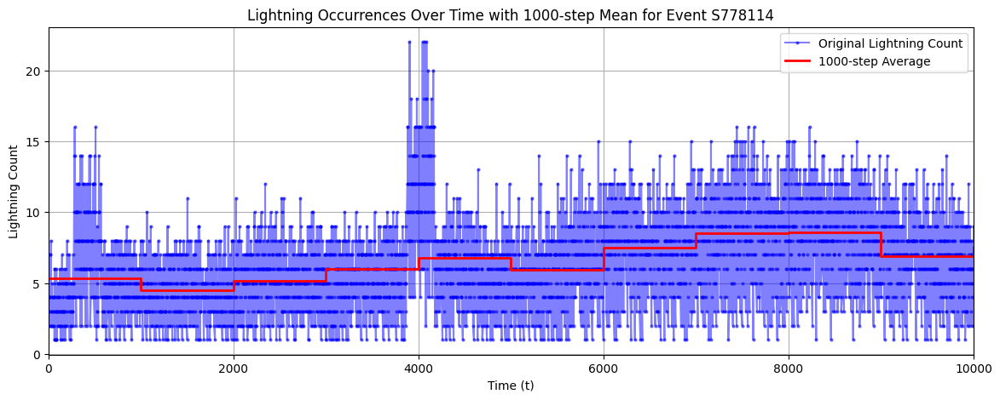

In [5]:
plot_lightning_occurrences(event_id="S778114", start_time=0, end_time=11000, window_size=1000, xlim_start=0, xlim_end=10000)

---
## **3. Distributing the Flashes Over Time**  

A key challenge was how to distribute the **N** predicted flashes across the **300 seconds** following each frame.  

### **Why Interpolation Wasn’t Feasible**  
Initially, we considered **interpolating between frames** to predict the number and locations of flashes at a finer temporal resolution. However, this approach had major drawbacks:  
- **Simple pixel-wise interpolation** would only fade high-intensity pixel values in and out, offering no meaningful insights.  
- **Motion tracking** was required for proper interpolation, but it **exceeded GPU memory limits**, even on an **A100 GPU**.  

### **Our Final Strategy**  
Given these challenges, we opted for a simpler yet effective approach:  
1. **Predict the lightning count and location** only for each frame (accumulated over the next 300s).  
2. **Evenly distribute these flashes over time**, rather than attempting complex temporal modeling.  
3. **Randomly assign each flash** to one of the predicted spatial locations.  

### **Why This Works**  
- **High Lightning Density:** Most lightning flashes cluster in areas of high pixel intensity, making spatial prediction more reliable than precise time prediction.  
- **Time Allocation is Necessary:** Regardless of method, lightning flashes must be distributed within the 300s window. A uniform spread avoids artificial patterns.  
- **Approximate Time Accuracy:** While our method introduces some randomness, the clustering of lightning ensures that many flashes will be assigned to **near-accurate** time points.  

### **Final Thoughts**  
By leveraging the **even assignment of time points**, we can approximate the timing of lightning strikes. While not perfect, this approach balances accuracy and efficiency, avoiding the computational burden of motion tracking while still capturing realistic lightning distributions.

---

## **4. Final Results and Conclusion**  

This final approach significantly **reduced computational overhead**, allowing for **faster model training and iteration** while maintaining **high prediction accuracy**.  

Despite our initial belief that a **simpler approach** might be less effective, it ultimately outperformed the **deep learning-only** strategy. This highlights the importance of **breaking complex problems into smaller, more manageable subtasks** in machine learning.  

In [6]:
# Instantiate model
model = LightningCNN()
print(model)

LightningCNN(
  (conv_layers): Sequential(
    (0): Conv2d(4, 16, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (1): ReLU()
    (2): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    (3): Conv2d(16, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (4): ReLU()
    (5): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    (6): Conv2d(32, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (7): ReLU()
    (8): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    (9): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (10): ReLU()
    (11): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  )
  (fc_layers): Sequential(
    (0): Flatten(start_dim=1, end_dim=-1)
    (1): Linear(in_features=73728, out_features=256, bias=True)
    (2): ReLU()
    (3): Linear(in_features=256, out_features=64, bias=True)
    (4): ReLU()
    (5): Linear(in_featur

# **The final LightningCNN: A Convolutional Neural Network for Lightning Prediction**

## **Overview**
Our goal was to **predict lightning occurrences** using multi-channel meteorological images. Rather than treating this as a time-series problem, we designed **LightningCNN**, a **Convolutional Neural Network (CNN)** that focuses on extracting **spatial features** from satellite images to estimate the number of lightning strikes in a given time frame.

By separating the **count prediction** from the **spatial and temporal distribution**, we simplified the problem and improved model performance.

---

## **Design Choices: Why This Approach?**

### **1. Predicting Count Before Location**
Instead of trying to predict both the **count** and **exact locations** of lightning strikes in a single step, we **split the problem** into two stages:
1. **CNN predicts the number of flashes per frame (5-minute window).**
2. **A probability-based method assigns locations based on storm intensity patterns.**

📌 **Why?** Predicting both count and location simultaneously would force the model to learn two fundamentally different patterns at once, reducing accuracy.

---

### **2. Using a CNN Instead of a Time-Series Model**
We initially considered time-series models like **RNNs/LSTMs** but opted for a **CNN-based approach** for several reasons:
- **CNNs excel at spatial pattern recognition**, which is critical for storm-related predictions.
- **Frame-by-frame analysis is sufficient** for our needs since storms evolve relatively slowly in 5-minute intervals.
- **LSTMs require more sequential dependencies**, which we lack in our data.

---

### **3. Architecture Breakdown**
The model consists of **two key components**:

1. **Convolutional Feature Extractor**
   - Processes **4-channel meteorological images** (`vil`, `ir069`, `ir107`, `vis`).
   - Uses **4 convolutional layers** to capture storm patterns.
   - **Max-pooling** reduces spatial size while preserving essential features.

2. **Fully Connected Prediction Head**
   - **Flattens** extracted features and processes them through **3 dense layers**.
   - Uses **Softplus activation** in the final layer to ensure **non-negative outputs**.

📌 **Why?** The model needs to output a single value (**lightning count**) while retaining spatial storm characteristics.

```python
def forward(self, x):
    x = self.conv_layers(x)  # Extract storm features
    x = self.fc_layers(x)    # Predict number of flashes
    return x.squeeze()       # Return a single scalar

In [3]:

# Set random seed for reproducibility
random.seed(42)
torch.manual_seed(42)

# Load all event IDs
with h5py.File(f'data/train.h5', "r") as h5_file:
    all_event_ids = list(h5_file.keys())

# **Define split sizes**
num_train = int(0.60 * len(all_event_ids))  # 20% for training
num_val = int(0.05 * len(all_event_ids))    # 5% for validation
num_test = int(0.05 * len(all_event_ids))   # 5% for testing

# **Randomly shuffle event IDs**
random.shuffle(all_event_ids)

# **Assign unique events to each split**
train_event_ids = all_event_ids[:num_train]
val_event_ids = all_event_ids[num_train:num_train + num_val]
test_event_ids = all_event_ids[num_train + num_val:num_train + num_val + num_test]

# **Ensure distinct sets**
assert len(set(train_event_ids) & set(val_event_ids)) == 0  # No overlap
assert len(set(train_event_ids) & set(test_event_ids)) == 0
assert len(set(val_event_ids) & set(test_event_ids)) == 0

# **Initialize datasets**
with h5py.File(f'data/train.h5', "r") as h5_file:
    train_dataset = LightningDataset(h5_file, event_ids=train_event_ids)
    val_dataset = LightningDataset(h5_file, event_ids=val_event_ids)
    test_dataset = LightningDataset(h5_file, event_ids=test_event_ids)

# **Create DataLoaders**
train_loader = DataLoader(train_dataset, batch_size=128, shuffle=True, num_workers=4, pin_memory=True)
val_loader = DataLoader(val_dataset, batch_size=128, shuffle=False, num_workers=2, pin_memory=True)
test_loader = DataLoader(test_dataset, batch_size=128, shuffle=False, num_workers=2, pin_memory=True)


# **Initialize model, optimizer, loss function**
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
model = LightningCNN().to(device)
optimizer = optim.Adam(model.parameters(), lr=0.0005)  # Lower LR for stability
loss_fn = nn.MSELoss()


In [ ]:
# **Enable mixed precision training**
scaler = torch.cuda.amp.GradScaler()

# **Training loop**
num_epochs = 8
for epoch in range(num_epochs):
    total_loss = 0
    model.train()

    for inputs, targets in train_loader:
        inputs, targets = inputs.to(device), targets.to(device)

        optimizer.zero_grad()

        with torch.cuda.amp.autocast():  # Enable mixed precision
            outputs = model(inputs)
            loss = loss_fn(outputs, targets)

        scaler.scale(loss).backward()
        scaler.step(optimizer)
        scaler.update()

        total_loss += loss.item()

    # **Print loss after the full epoch**
    avg_train_loss = total_loss / len(train_loader)
    print(f"Epoch {epoch+1}/{num_epochs}, Training Loss: {avg_train_loss:.4f}")

    # **Validation Step (Runs once per epoch)**
    model.eval()
    val_loss = 0
    with torch.no_grad():
        for inputs, targets in val_loader:
            inputs, targets = inputs.to(device), targets.to(device)
            outputs = model(inputs)
            loss = loss_fn(outputs, targets)
            val_loss += loss.item()

    # **Print validation loss after the full epoch**
    avg_val_loss = val_loss / len(val_loader)
    print(f"Epoch {epoch+1}/{num_epochs}, Validation Loss: {avg_val_loss:.4f}")

print("Training Complete!")

# **Test Evaluation**
model.eval()
test_loss = 0
with torch.no_grad():
    for inputs, targets in test_loader:
        inputs, targets = inputs.to(device), targets.to(device)
        outputs = model(inputs)
        loss = loss_fn(outputs, targets)
        test_loss += loss.item()

print(f"Final Test Loss: {test_loss/len(test_loader):.4f}")

<ipython-input-38-4950fdabe1ab>:52: FutureWarning: `torch.cuda.amp.GradScaler(args...)` is deprecated. Please use `torch.amp.GradScaler('cuda', args...)` instead.
  scaler = torch.cuda.amp.GradScaler()
<ipython-input-38-4950fdabe1ab>:65: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with torch.cuda.amp.autocast():  # Enable mixed precision


Epoch 1/8, Training Loss: 76435.1533
Epoch 1/8, Validation Loss: 40375.5747
Epoch 2/8, Training Loss: 45362.7355
Epoch 2/8, Validation Loss: 59730.0809
Epoch 3/8, Training Loss: 38153.2922
Epoch 3/8, Validation Loss: 39064.5237
Epoch 4/8, Training Loss: 28799.6123
Epoch 4/8, Validation Loss: 20898.5234
Epoch 5/8, Training Loss: 21179.4012
Epoch 5/8, Validation Loss: 13511.0885
Epoch 6/8, Training Loss: 17541.8596
Epoch 6/8, Validation Loss: 16064.8986
Epoch 7/8, Training Loss: 14583.6078
Epoch 7/8, Validation Loss: 13592.2063
Epoch 8/8, Training Loss: 10380.3006
Epoch 8/8, Validation Loss: 13854.9718
Training Complete!
Final Test Loss: 25233.7945


In [ ]:
import torch

# Define model save path
model_path = "lightning_cnn.pth"

# Save the trained model
torch.save(model.state_dict(), model_path)

print(f"Model saved as {model_path}")

Model saved as lightning_cnn.pth


In [ ]:
from google.colab import files

files.download("lightning_cnn.pth")

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [4]:
import torch

# Define device (CPU or GPU)
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

# Recreate the model architecture
model = LightningCNN().to(device)  # Move model to the correct device

# Load the saved weights
model.load_state_dict(torch.load("lightning_cnn-60.pth", map_location=device))

# Switch model to evaluation mode
model.eval()

print("Model successfully loaded!")

Model successfully loaded!


<ipython-input-4-2aa5357d2c99>:10: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  model.load_state_dict(torch.load("lightning_cnn-60.pth", map_location=device))


In [5]:
# Switch model to evaluation mode
model.eval()

actual_counts = []
predicted_counts = []

with torch.no_grad():
    for inputs, targets in test_loader:
        inputs, targets = inputs.to(device),  targets.to(device)
        outputs = model(inputs).cpu().numpy()

        actual_counts.extend(targets.cpu().numpy())
        predicted_counts.extend(outputs)

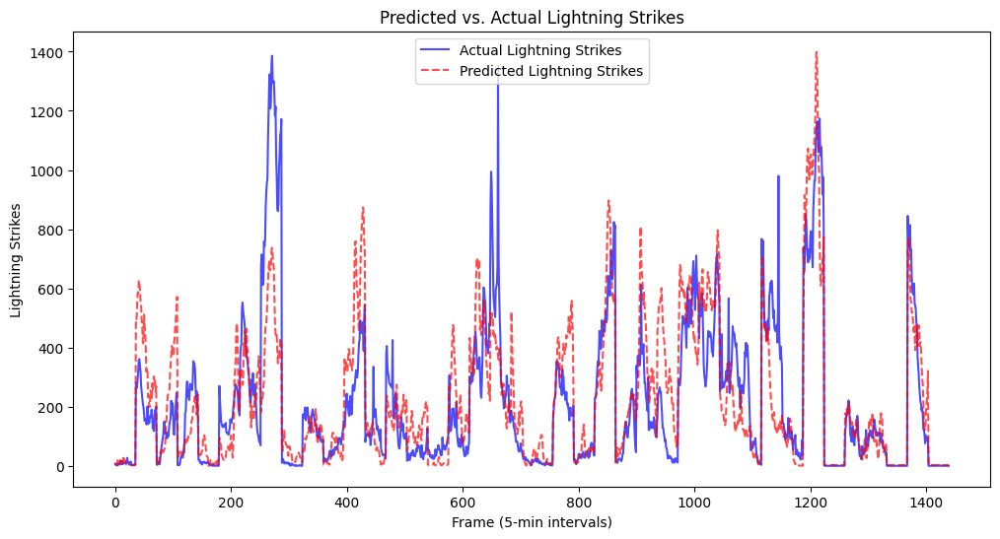

In [ ]:


# Plot actual vs. predicted counts
plt.figure(figsize=(12, 6))
plt.plot(actual_counts, label="Actual Lightning Strikes", color="blue", alpha=0.7)
plt.plot(predicted_counts, label="Predicted Lightning Strikes", color="red", linestyle="dashed", alpha=0.7)

plt.xlabel("Frame (5-min intervals)")
plt.ylabel("Lightning Strikes")
plt.title("Predicted vs. Actual Lightning Strikes")
plt.legend()
plt.show()

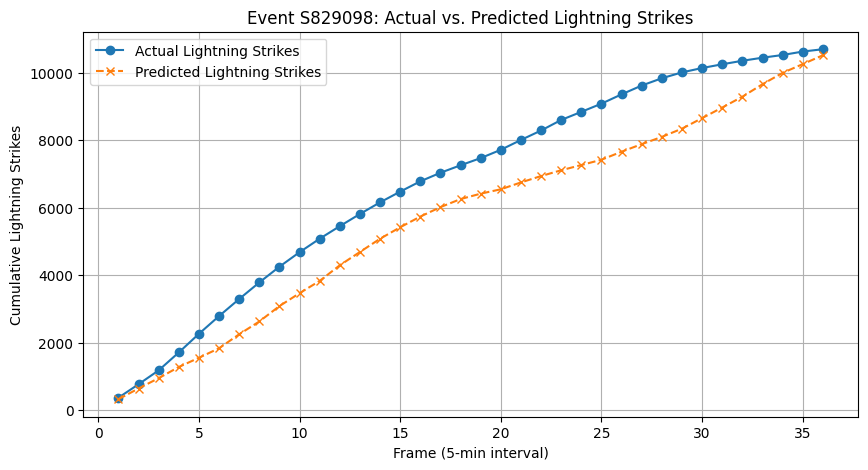

In [ ]:
import matplotlib.pyplot as plt
# **Usage Example**
event_to_plot = test_dataset.event_ids[6]  # Select first event in dataset
evaluate_model_on_event(model, test_dataset, event_to_plot, device)

# Location Prediction
### Now we evaluate the location of the flashes based on the highest pixels in Vis and Vil (as described at the beginning in more detail), we choose those two because our data exploration showed the highest resolution and correlation to the actual flash locations


In [6]:
num_frames_per_event = 36

model.eval()
actual_counts_per_event = {}
predicted_counts_per_event = {}
predicted_locations_per_event = {}

global_frame_idx = 0  # global counter that will go from 0 up to (#events * 36 - 1)

with torch.no_grad():
    for inputs, targets in test_loader:
        inputs = inputs.to(device)
        targets = targets.to(device)

        outputs = model(inputs)  # shape: (batch_size,)
        outputs = outputs.detach().cpu().numpy()
        targets = targets.detach().cpu().numpy()

        # inputs.shape is (batch_size, channels, height, width)
        # so if batch_size > 1, we iterate over them individually
        for i in range(len(outputs)):
            event_idx = global_frame_idx // num_frames_per_event
            frame_idx = global_frame_idx % num_frames_per_event

            event_id = test_dataset.event_ids[event_idx]  # or however you store it

            # Initialize dictionaries
            if event_id not in actual_counts_per_event:
                actual_counts_per_event[event_id] = [None] * num_frames_per_event
                predicted_counts_per_event[event_id] = [None] * num_frames_per_event
                predicted_locations_per_event[event_id] = [None] * num_frames_per_event

            # Convert predicted flash count to an int
            predicted_flashes = int(max(0, round(outputs[i])))

            # Extract VIS and VIL images from the i-th sample
            vis_image = inputs[i, 3, :, :].cpu().numpy()  # Channel 3 = VIS
            vil_image = inputs[i, 0, :, :].cpu().numpy()  # Channel 0 = VIL

            # Compute predicted flash locations using VIS & VIL
            flash_locations = predict_flash_locations(vis_image, vil_image, predicted_flashes)

            # Store actual/predicted counts and locations *in the correct slot*
            actual_counts_per_event[event_id][frame_idx] = targets[i]
            predicted_counts_per_event[event_id][frame_idx] = predicted_flashes
            predicted_locations_per_event[event_id][frame_idx] = flash_locations

            # Move on to the next frame globally
            global_frame_idx += 1

print("All predictions stored successfully!")

All predictions stored successfully!


In [7]:
def plot_flash_predictions(event_id, frame_indices, test_dataset):
    """
    Plots multiple frames for a given event, showing VIS image with actual & predicted flash locations.

    Args:
        event_id (str): Event ID to plot.
        frame_indices (list): List of frame indices to plot.
    """

    # **Reopen HDF5 file dynamically to fetch event data**
    with h5py.File(test_dataset.h5_file_path, "r") as h5_file:
        event_data = h5_file[event_id]

        # **Set up figure for multiple frames**
        fig, axes = plt.subplots(2, 5, figsize=(20, 8))  # 2 rows, 5 columns

        for ax, frame_idx in zip(axes.flat, frame_indices):
            # **Extract VIS image for this frame**
            vis_image = event_data["vis"][:, :, frame_idx]

            # **Extract actual lightning locations from the dataset**
            actual_flashes = event_data["lght"]  # Shape (num_flashes, 5)

            # **Filter flashes that occurred in this frame (5-min window)**
            time_start = frame_idx * 300  # Frame start time in seconds
            time_end = (frame_idx + 1) * 300  # Frame end time
            actual_flash_mask = (actual_flashes[:, 0] >= time_start) & (
                actual_flashes[:, 0] < time_end
            )
            actual_flash_coords = actual_flashes[actual_flash_mask][
                :, [3, 4]
            ]  # Extract x (col 4) & y (col 5)

            # **Extract predicted flash locations from probability distribution**
            predicted_locations = predicted_locations_per_event[event_id][frame_idx]

            # **Plot VIS image as background**
            ax.imshow(vis_image, cmap="gray", vmin=0, vmax=10000)

            # **Overlay actual lightning locations**
            if len(actual_flash_coords) > 0:
                ax.scatter(
                    actual_flash_coords[:, 0],
                    actual_flash_coords[:, 1],
                    color="red",
                    marker="x",
                    s=50,
                    label="Actual Flashes",
                )

            # **Overlay predicted lightning locations**
            if len(predicted_locations) > 0:
                predicted_x, predicted_y = zip(*predicted_locations)
                ax.scatter(
                    predicted_x,
                    predicted_y,
                    color="blue",
                    marker="+",
                    s=50,
                    label="Predicted Flashes",
                )

            # **Plot settings**
            ax.set_title(f"Frame {frame_idx}")
            ax.set_xticks([])
            ax.set_yticks([])

        # **Legend & Layout**
        handles = [
            plt.Line2D(
                [0],
                [0],
                marker="x",
                color="r",
                linestyle="None",
                markersize=8,
                label="Actual Flashes",
            ),
            plt.Line2D(
                [0],
                [0],
                marker="+",
                color="b",
                linestyle="None",
                markersize=8,
                label="Predicted Flashes",
            ),
        ]
        fig.legend(handles=handles, loc="upper center", ncol=2)
        plt.suptitle(
            f"Event {event_id}: Actual vs. Predicted Lightning Locations", fontsize=16
        )
        plt.tight_layout(rect=[0, 0, 1, 0.95])
        plt.show()


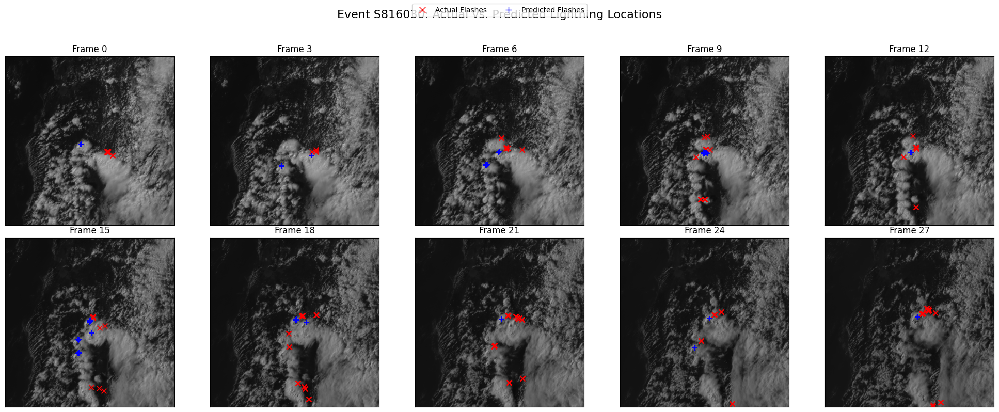

Plotted Event: S816030


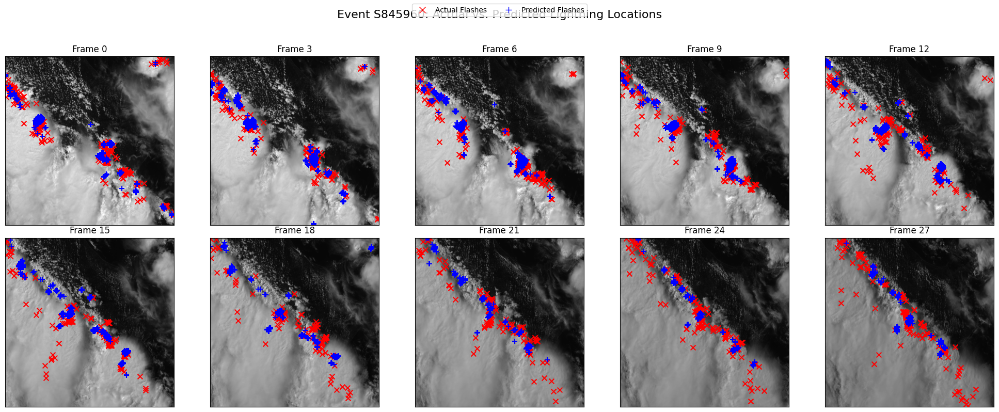

Plotted Event: S845960


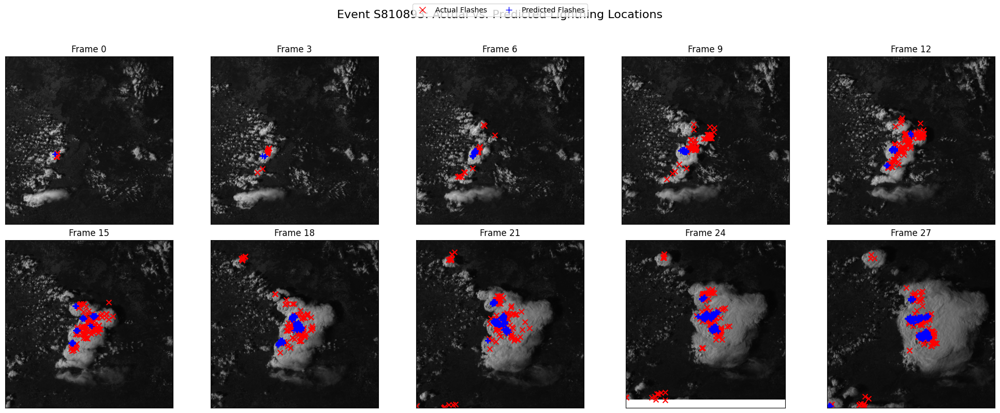

Plotted Event: S810893


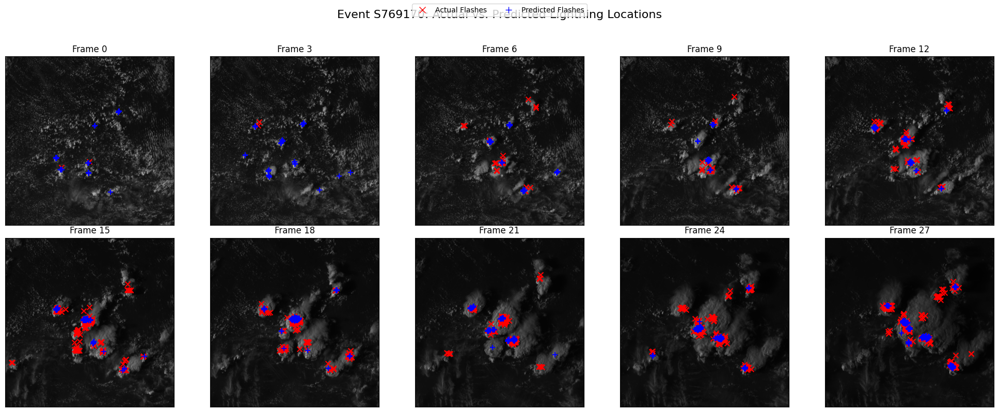

Plotted Event: S769170


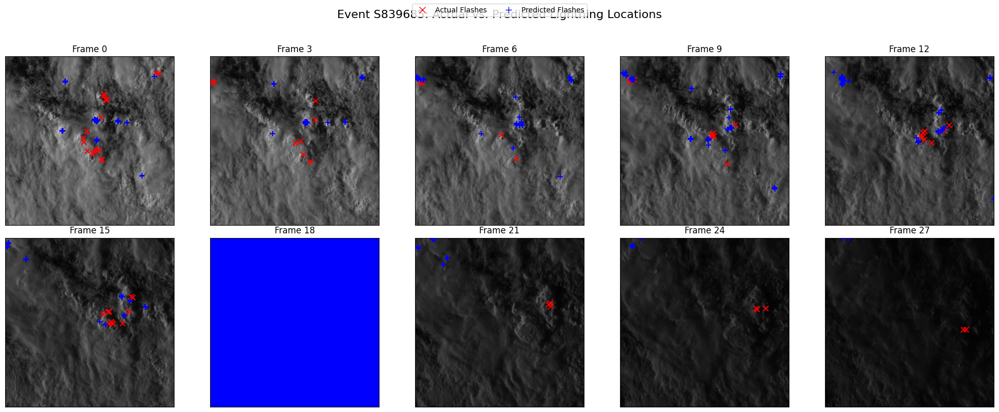

Plotted Event: S839685


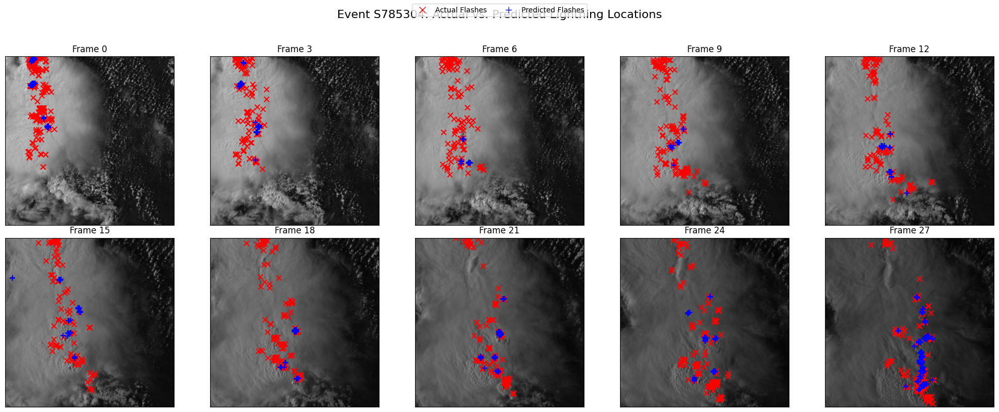

Plotted Event: S785304


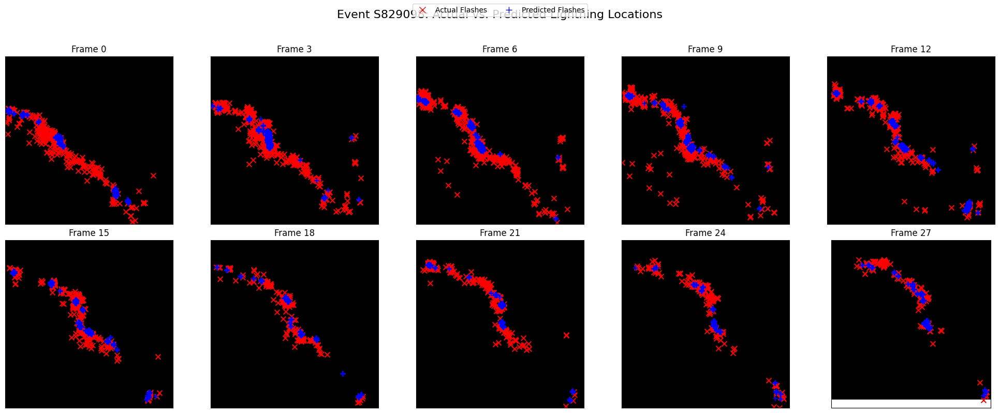

Plotted Event: S829098


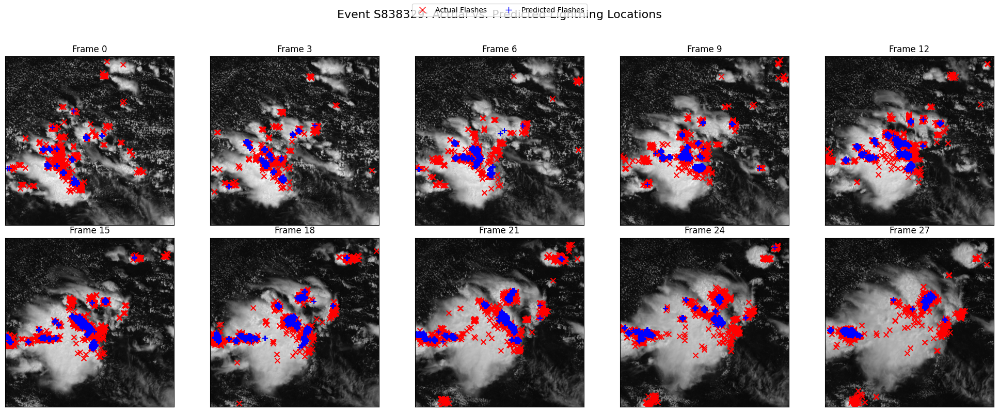

Plotted Event: S838329


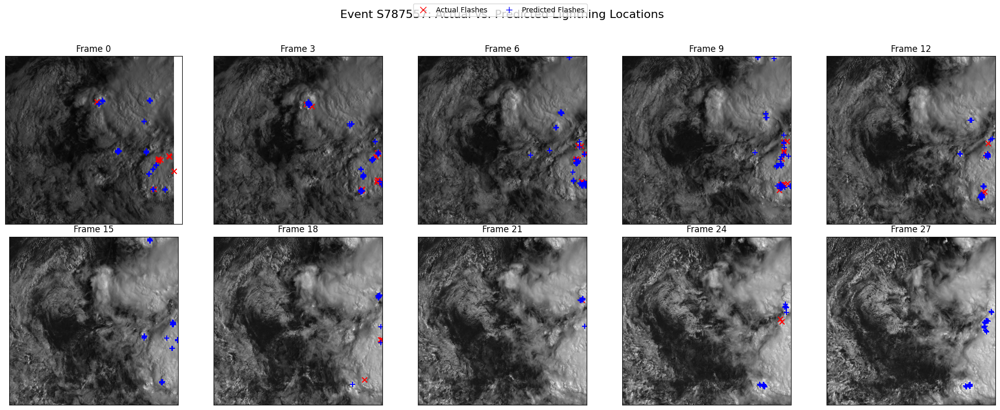

Plotted Event: S787557


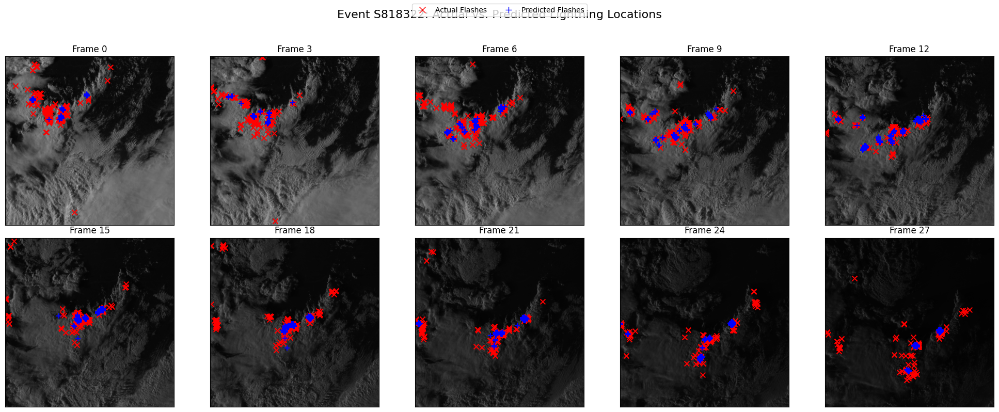

Plotted Event: S818322


In [15]:


for event_index in range(10):
        # Set this number to shuffle through events (change this to see different events)
        #event_index = 2 # Change this number (0 to len(test_dataset.event_ids) - 1)

        # Select event based on index
        selected_event = test_dataset.event_ids[event_index]

        # Select 10 frames (modify as needed)
        frame_indices = list(range(0, 36, 3))[:10]

        # Plot selected event
        plot_flash_predictions(selected_event, frame_indices, test_dataset)

        print(f"Plotted Event: {selected_event}")

In [9]:

def distribute_flashes_randomly_over_time(event_index):
    """
    Distributes predicted flashes over 300 seconds per frame for an event specified by index.
    Ensures the output is sorted by time (`t`).

    Args:
        event_index (int): The index of the event in `test_dataset.event_ids`.

    Returns:
        torch.Tensor: A tensor of shape (10800, 3) with (t, x, y) for predicted flashes, sorted by `t`.
    """

    # **Retrieve the event ID using the index**
    if event_index >= len(test_dataset.event_ids):
        raise IndexError(
            f"Event index {event_index} is out of range. Max: {len(test_dataset.event_ids)-1}"
        )

    event_id = test_dataset.event_ids[event_index]
    print(f"Processing Event: {event_id}")

    # **Ensure event exists in predictions**
    if (
        event_id not in predicted_counts_per_event
        or event_id not in predicted_locations_per_event
    ):
        raise KeyError(f"Event ID {event_id} not found in predicted data.")

    num_frames = 36  # Each event has 36 frames
    seconds_per_frame = 300  # 5 minutes per frame
    total_seconds = num_frames * seconds_per_frame  # 10800 seconds

    flash_data = []  # Store (t, x, y) tuples

    for frame_idx in range(num_frames):
        start_time = frame_idx * seconds_per_frame  # Start second for the frame
        end_time = start_time + seconds_per_frame  # End second

        # **Retrieve predicted flashes and locations safely**
        predicted_flashes = (
            predicted_counts_per_event[event_id][frame_idx]
            if frame_idx < len(predicted_counts_per_event[event_id])
            else 0
        )
        predicted_locations = (
            predicted_locations_per_event[event_id][frame_idx]
            if frame_idx < len(predicted_locations_per_event[event_id])
            else []
        )

        if predicted_flashes == 0 or not predicted_locations:
            continue  # Skip empty frames

        # **Randomly assign times for flashes within the 300s window**
        flash_times = np.random.randint(start_time, end_time, size=predicted_flashes)
        flash_coords = np.array(
            predicted_locations[:predicted_flashes]
        )  # Get top `predicted_flashes` locations

        # **Ensure enough locations exist**
        if flash_coords.shape[0] < predicted_flashes:
            extra_needed = predicted_flashes - flash_coords.shape[0]
            extra_coords = np.random.choice(
                flash_coords, size=extra_needed, replace=True
            )
            flash_coords = np.vstack((flash_coords, extra_coords))

        # **Stack (t, x, y)**
        flash_data.extend(np.column_stack((flash_times, flash_coords)))

    # **Convert to Tensor**
    flash_tensor = torch.tensor(flash_data, dtype=torch.float32)

    # **Sort the tensor by `t` (column 0)**
    flash_tensor = flash_tensor[flash_tensor[:, 0].argsort()]

    return flash_tensor


def distribute_flashes_evenly_over_time(event_index):
    """
    Distributes predicted flashes evenly across 300 seconds per frame.
    Flash locations are randomly assigned from available predictions.

    Args:
        event_index (int): The index of the event in `test_dataset.event_ids`.

    Returns:
        torch.Tensor: A tensor of shape (10800, 3) with (t, x, y) for predicted flashes, sorted by `t`.
    """

    # **Retrieve the event ID using the index**
    if event_index >= len(test_dataset.event_ids):
        raise IndexError(
            f"Event index {event_index} is out of range. Max: {len(test_dataset.event_ids)-1}"
        )

    event_id = test_dataset.event_ids[event_index]
    print(f"Processing Event: {event_id}")

    # **Ensure event exists in predictions**
    if (
        event_id not in predicted_counts_per_event
        or event_id not in predicted_locations_per_event
    ):
        raise KeyError(f"Event ID {event_id} not found in predicted data.")

    num_frames = 36  # Each event has 36 frames
    seconds_per_frame = 300  # 5 minutes per frame
    total_seconds = num_frames * seconds_per_frame  # 10800 seconds

    flash_data = []  # Store (t, x, y) tuples

    for frame_idx in range(num_frames):
        start_time = frame_idx * seconds_per_frame  # Start second for the frame
        end_time = start_time + seconds_per_frame  # End second

        # **Retrieve predicted flashes and locations safely**
        predicted_flashes = (
            predicted_counts_per_event[event_id][frame_idx]
            if frame_idx < len(predicted_counts_per_event[event_id])
            else 0
        )
        predicted_locations = (
            predicted_locations_per_event[event_id][frame_idx]
            if frame_idx < len(predicted_locations_per_event[event_id])
            else []
        )

        if predicted_flashes == 0 or not predicted_locations:
            continue  # Skip empty frames

        # **Evenly distribute flash times**
        if predicted_flashes > 1:
            flash_times = np.linspace(
                start_time, end_time - 1, num=predicted_flashes, dtype=int
            )
        else:
            flash_times = np.array(
                [start_time + seconds_per_frame // 2]
            )  # Place in middle if only 1 flash

        # **Randomly assign locations from predicted list**
        flash_coords = np.array(predicted_locations)

        # **Ensure we have enough locations (if fewer locations than flashes, duplicate some)**
        if flash_coords.shape[0] < predicted_flashes:
            extra_needed = predicted_flashes - flash_coords.shape[0]
            extra_coords = np.random.choice(
                flash_coords, size=extra_needed, replace=True
            )
            flash_coords = np.vstack((flash_coords, extra_coords))

        # **Shuffle locations to prevent structured patterns**
        np.random.shuffle(flash_coords)

        # **Stack (t, x, y)**
        flash_data.extend(
            np.column_stack((flash_times, flash_coords[:predicted_flashes]))
        )

    # **Convert to Tensor**
    flash_tensor = torch.tensor(flash_data, dtype=torch.float32)
    return flash_tensor

In [10]:
event_index = 2  # Change this number to select a different event from test_dataset
flash_tensor = distribute_flashes_randomly_over_time(event_index)

print("Flash Tensor Shape:", flash_tensor.shape)  # Should be (10800, 3)
print(flash_tensor[:10])  # Print first 10 rows

Processing Event: S810893
Flash Tensor Shape: torch.Size([7648, 3])
tensor([[ 50., 114., 223.],
        [250., 115., 223.],
        [258., 113., 223.],
        [301., 116., 222.],
        [333., 115., 222.],
        [478., 116., 223.],
        [550., 115., 223.],
        [638.,  56., 320.],
        [732.,  59., 319.],
        [827., 118., 222.]])


<ipython-input-9-bbc4f50457d0>:72: UserWarning: Creating a tensor from a list of numpy.ndarrays is extremely slow. Please consider converting the list to a single numpy.ndarray with numpy.array() before converting to a tensor. (Triggered internally at ../torch/csrc/utils/tensor_new.cpp:278.)
  flash_tensor = torch.tensor(flash_data, dtype=torch.float32)


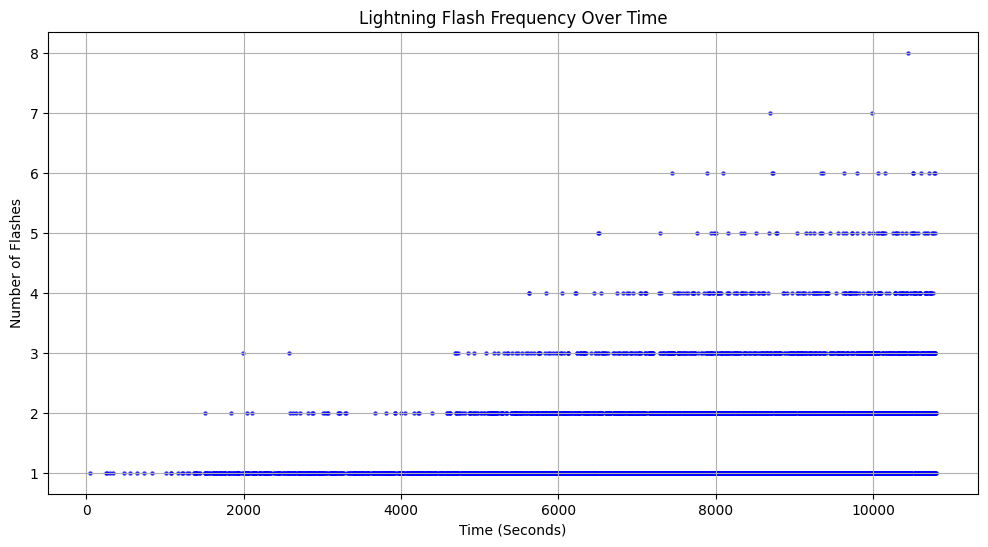

In [11]:
import matplotlib.pyplot as plt
import numpy as np
import torch

# Extract time values (first column)
time_values = flash_tensor[:, 0].cpu().numpy().astype(int)  # Convert to numpy for processing

# Count the number of flashes per second
unique_times, flash_counts = np.unique(time_values, return_counts=True)

# Plot as small dots
plt.figure(figsize=(12, 6))
plt.scatter(unique_times, flash_counts, s=5, color="blue", alpha=0.7)  # `s=5` for small dots

plt.xlabel("Time (Seconds)")
plt.ylabel("Number of Flashes")
plt.title("Lightning Flash Frequency Over Time")
plt.grid(True)
plt.show()

In [13]:
event_index = 2  # Change this to select a different event
flash_tensor = distribute_flashes_evenly_over_time(event_index)

print("Flash Tensor Shape:", flash_tensor.shape)  # Should be (10800, 3)
print(flash_tensor[:10])  # Print first 10 rows

Processing Event: S810893
Flash Tensor Shape: torch.Size([7648, 3])
tensor([[  0., 113., 223.],
        [149., 115., 223.],
        [299., 114., 223.],
        [300., 116., 223.],
        [399., 115., 223.],
        [499., 115., 222.],
        [599., 116., 222.],
        [600.,  59., 319.],
        [749.,  56., 320.],
        [899., 118., 222.]])


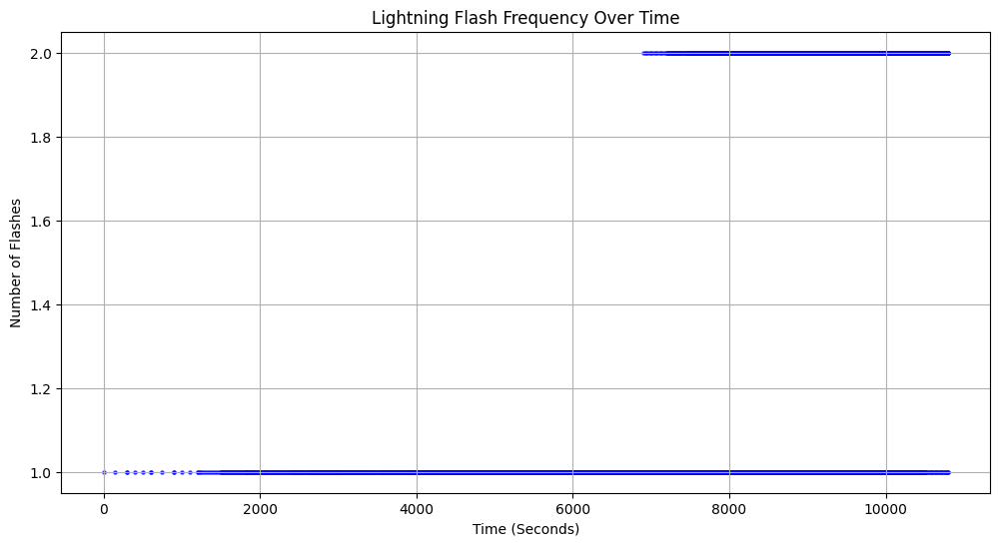

In [14]:
import matplotlib.pyplot as plt
import numpy as np
import torch

# Extract time values (first column)
time_values = flash_tensor[:, 0].cpu().numpy().astype(int)  # Convert to numpy for processing

# Count the number of flashes per second
unique_times, flash_counts = np.unique(time_values, return_counts=True)

# Plot as small dots
plt.figure(figsize=(12, 6))
plt.scatter(unique_times, flash_counts, s=5, color="blue", alpha=0.7)  # `s=5` for small dots

plt.xlabel("Time (Seconds)")
plt.ylabel("Number of Flashes")
plt.title("Lightning Flash Frequency Over Time")
plt.grid(True)
plt.show()


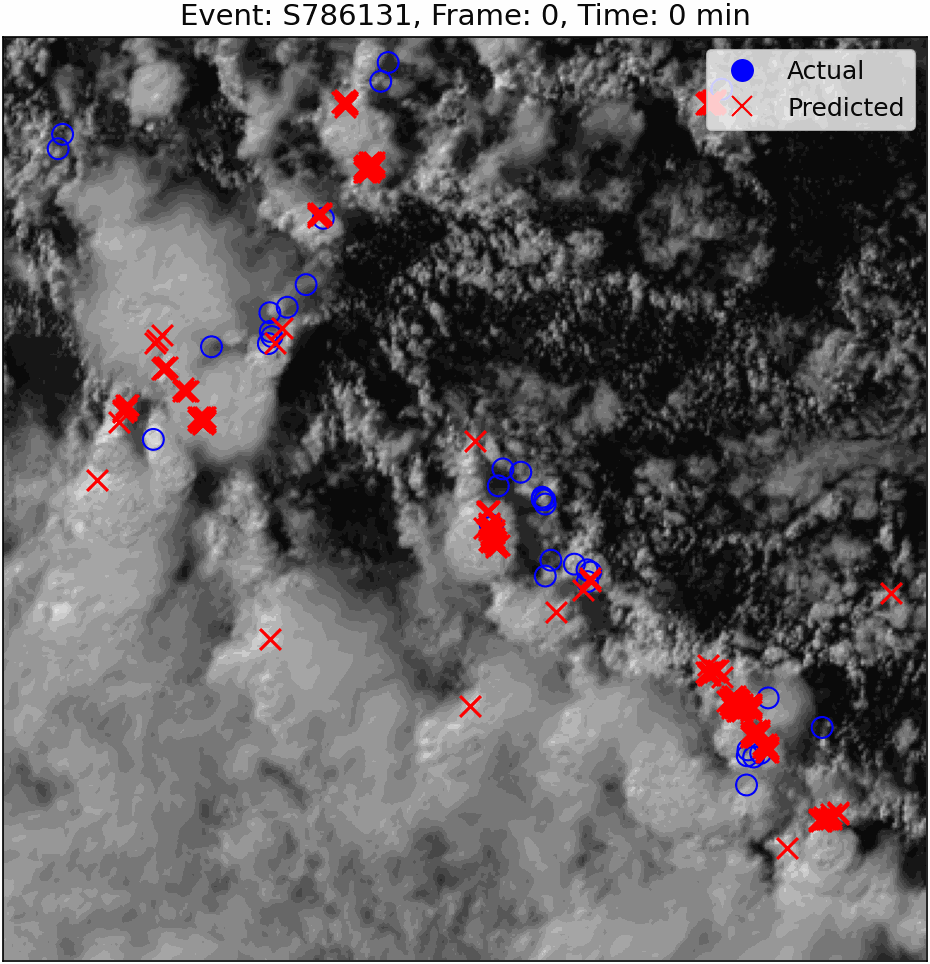

In [ ]:
from IPython.display import HTML
import base64

# Replace 'your_animation.gif' with the path to your GIF file
gif_path = '/content/model3gif.gif'

with open(gif_path, 'rb') as gif_file:
    encoded_gif = base64.b64encode(gif_file.read()).decode('utf-8')

html = f'<img src="data:image/gif;base64,{encoded_gif}" alt="Embedded GIF">'

HTML(html)




# **Bonus Task: Impact of Training Set Size on LightningCNN Performance**

## **Overview**
In this bonus task, we aimed to evaluate how the size of the training dataset affects the **test performance** of our LightningCNN model. Specifically, we analyzed the **Test Mean Squared Error (MSE) Loss** as a function of the number of training events.

## **Findings**
As expected, the **test loss consistently decreases as the training dataset size increases**, which aligns with our intuition that a larger dataset helps the model generalize better. However, the rate of improvement is not uniform.

### **Key Observations:**
1. **Sharp Initial Decline (0 - 400 events)**  
   - The test loss **drops significantly** as the dataset size increases from **100 to 400 events**.
   - This suggests that the model was previously underfitting, and adding more data allowed it to capture more relevant patterns.

2. **Performance Plateau (~400+ events)**  
   - After **400 training events**, the improvement slows down, and the test loss flattens out.
   - This indicates that beyond a certain dataset size, additional data provides **diminishing returns** in terms of MSE reduction.

3. **Comparison to Previous Model**
   - Unlike our **previous deep CNN model with multiple convolutional layers**, this model does not show as steep of an improvement with additional data.
   - The architecture of LightningCNN might be **less data-hungry** or might already reach its capacity with a relatively smaller dataset.

## **Conclusion**
Our analysis confirms that **increasing the dataset size improves model performance**, but only up to a certain point. Beyond **400 training events**, the benefits diminish, suggesting that further enhancements may require **architectural changes**, **feature engineering**, or **regularization techniques** rather than just more data.

This finding provides valuable insights for future optimizations and resource allocation for training deep learning models on meteorological data.

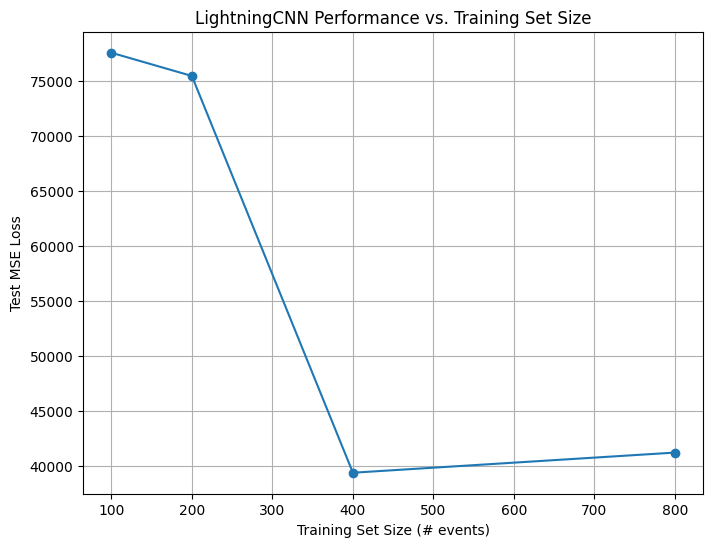

In [ ]:
from IPython.display import display, Image

display(Image(filename="bonustasklightning cnn.png"))